<a href="https://colab.research.google.com/github/jfg50/GAN-face-generator/blob/main/Assignment3_DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Generative Adversarial Networks (GANs)**

# **Setup**

In [ ]:
!pip install tensorflow_gan

try:
  %tensorflow_version 2.x
except Exception:
  pass

import tensorflow as tf
import numpy as np
import glob
import imageio
import os
import PIL
from tensorflow.keras import layers
import time

from IPython import display

tf.keras.backend.set_floatx('float32')

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

%matplotlib inline

def display_images(images, save=None):
  fig = plt.figure(figsize=(8, 8))

  for i in range(min(images.shape[0], 16)):
      plt.subplot(4, 4, i+1)
      plt.imshow((images[i, :, :, :] * 127.5 + 127.5).numpy().astype(np.uint8))
      plt.axis('off')

  if save is not None:
      plt.savefig(save)
  plt.show()

## --------------------------------------------------------------------------------------
import tensorflow_hub as hub
import tensorflow_gan as tfgan

# For evaluating the quality of generated images
# Frechet Inception Distance measures how similar the generated images are to the real ones
# https://nealjean.com/ml/frechet-inception-distance/
# Lower is better
module = tf.keras.Sequential([hub.KerasLayer("https://tfhub.dev/google/tf2-preview/inception_v3/classification/4", output_shape=[1001])])
def fid_function(real_image_batch, generated_image_batch):
    """
    Given a batch of real images and a batch of generated images, this function pulls down a pre-trained inception 
    v3 network and then uses it to extract the activations for both the real and generated images. The distance of 
    these activations is then computed. The distance is a measure of how "realistic" the generated images are.

    :param real_image_batch: a batch of real images from the dataset, shape=[batch_size, height, width, channels]
    :param generated_image_batch: a batch of images generated by the generator network, shape=[batch_size, height, width, channels]

    :return: the inception distance between the real and generated images, scalar
    """
    INCEPTION_IMAGE_SIZE = (299, 299)
    real_resized = tf.image.resize(real_image_batch, INCEPTION_IMAGE_SIZE)
    fake_resized = tf.image.resize(generated_image_batch, INCEPTION_IMAGE_SIZE)
    module.build([None, 299, 299, 3])
    real_features = module(real_resized)
    fake_features = module(fake_resized)
    return tfgan.eval.frechet_classifier_distance_from_activations(real_features, fake_features)

##Load dataset

In [ ]:
![ -f 'img_align_celeba.zip' ] || wget --content-disposition https://www.dropbox.com/s/o2cfewccmxqrg2x/img_align_celeba.zip?dl=0

![ -d '/content/dataset' ] || unzip -q -d /content/dataset img_align_celeba.zip

In [ ]:
# Sets up tensorflow graph to load images
# (This is the version using new-style tf.data API)
def load_image_batch(dir_name, batch_size=128, shuffle_buffer_size=250000, n_threads=2):
    """
    Given a directory and a batch size, the following method returns a dataset iterator that can be queried for 
    a batch of images

    :param dir_name: a batch of images
    :param batch_size: the batch size of images that will be trained on each time
    :param shuffle_buffer_size: representing the number of elements from this dataset from which the new dataset will 
    sample
    :param n_thread: the number of threads that will be used to fetch the data

    :return: an iterator into the dataset
    """
    # Function used to load and pre-process image files
    # (Have to define this ahead of time b/c Python does allow multi-line
    #    lambdas, *grumble*)
    def load_and_process_image(file_path):
        """
        Given a file path, this function opens and decodes the image stored in the file.

        :param file_path: a batch of images

        :return: an rgb image
        """
        # Load image
        image = tf.io.decode_jpeg(tf.io.read_file(file_path), channels=3)
        image = tf.image.resize(image, [64,64])
        
        # Convert image to normalized float (0, 1)
        image = tf.image.convert_image_dtype(image, tf.float32) / 256.0
        # Rescale data to range (-1, 1)
        image = (image - 0.5) * 2
        return image

    # List file names/file paths
    dir_path = dir_name + '/*.jpg'
    dataset = tf.data.Dataset.list_files(dir_path)

    # Shuffle order
    dataset = dataset.shuffle(buffer_size=shuffle_buffer_size)

    # Load and process images (in parallel)
    dataset = dataset.map(map_func=load_and_process_image, num_parallel_calls=n_threads)

    # Create batch, dropping the final one which has less than batch_size elements and finally set to reshuffle
    # the dataset at the end of each iteration
    dataset = dataset.batch(batch_size, drop_remainder=True)

    # Prefetch the next batch while the GPU is training
    dataset = dataset.prefetch(1)

    # Return an iterator over this dataset
    return dataset

# **Building the Discriminator and the Generator**

In [ ]:
# GEN_DEPTH = 1024 #uncomment for the full scale model
GEN_DEPTH = 128
KERNEL_DEPTH = GEN_DEPTH // 2

def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(4*4*GEN_DEPTH, use_bias=False, input_shape=(100,)))
    model.add(layers.Reshape((4, 4, GEN_DEPTH)))

    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(GEN_DEPTH // 2, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 8, 8, GEN_DEPTH // 2)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(GEN_DEPTH // 4, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 16, 16, GEN_DEPTH // 4)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(GEN_DEPTH // 8, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 32, 32, GEN_DEPTH // 8)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 64, 64, 3)

    return model

def make_discriminator_model():
    model = tf.keras.Sequential()

    model.add(layers.Conv2D(GEN_DEPTH // 8, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[64, 64, 3]))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(GEN_DEPTH // 4, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(GEN_DEPTH // 2, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.3))
    
    #TODO: fill in the discriminator model layers

    model.add(layers.Flatten())
    model.add(layers.Dense(1))
    return model

In [ ]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

# Training


In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images, batch_size):
    noise = tf.random.normal([batch_size, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return generated_images, gen_loss, disc_loss

# Train the model for one epoch.
def train_epoch(generator, discriminator, dataset_iterator, manager, batch_size, validate_image_seeds=None):
    """
    Train the model for one epoch. Save a checkpoint every 500 or so batches.

    :param generator: generator model
    :param discriminator: discriminator model
    :param dataset_ierator: iterator over dataset, see preprocess.py for more information
    :param manager: the manager that handles saving checkpoints by calling save()

    :return: The average FID score over the epoch
    """
    overall_fid = 0
    count = 0
    # Loop over our data until we run out
    for iteration, batch in enumerate(dataset_iterator):
        count += 1
        generated_images, gen_loss, disc_loss = train_step(batch, batch_size)

        # Calculate inception distance and track the fid in order
        # to return the average
        if iteration % 100 == 0:
            print("iteration ",iteration, " gen loss", gen_loss.numpy(), " disc loss", disc_loss.numpy())
            fid_ = fid_function(batch, generated_images)
            overall_fid += fid_
            print('**** INCEPTION DISTANCE: %g ****' % fid_)
            if validate_image_seeds is not None:
              display_images(generator(validate_image_seeds, training=False))
            else:
              display_images(generated_images)
        if iteration % 500 == 0:
            # Save
            manager.save()
    print(overall_fid)
    return tf.keras.backend.get_value(overall_fid) / count

#main

In [ ]:
EPOCHS = 3
noise_dim = 100
num_examples_to_generate = 16
batch_size = 128

img_dir = '/content/dataset/img_align_celeba'
out_dir = './output'
checkpoint_dir = './checkpoints'

mode = 'train'
# mode = 'test'
restore_checkpoint = (mode == 'test') or False


In [ ]:
# !rm -rf checkpoints

========================== EPOCH 0  ==========================
iteration  0  gen loss 1.3031425  disc loss 1.8137609
**** INCEPTION DISTANCE: 1862.05 ****


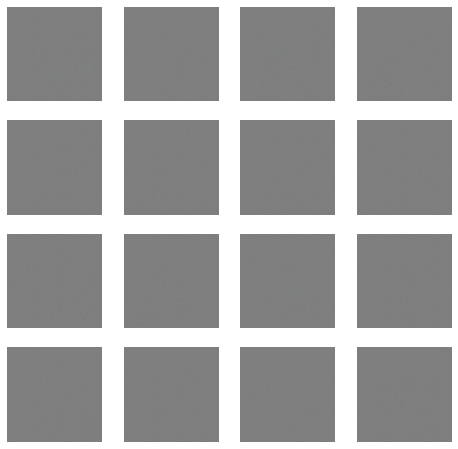

iteration  100  gen loss 1.8478546  disc loss 0.6733712
**** INCEPTION DISTANCE: 2115.14 ****


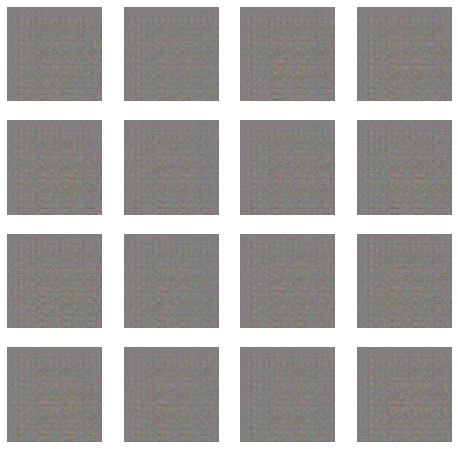

iteration  200  gen loss 2.2140324  disc loss 0.53929126
**** INCEPTION DISTANCE: 1642.12 ****


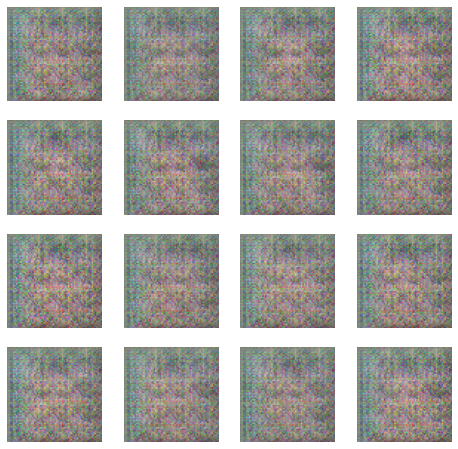

iteration  300  gen loss 2.5968199  disc loss 0.4138441
**** INCEPTION DISTANCE: 1320.63 ****


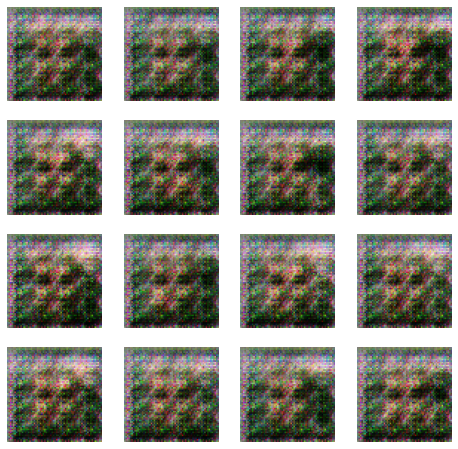

iteration  400  gen loss 2.7678354  disc loss 0.3748666
**** INCEPTION DISTANCE: 867.061 ****


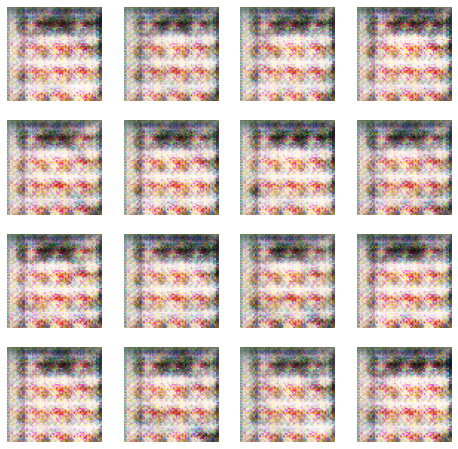

iteration  500  gen loss 2.5764444  disc loss 0.53220224
**** INCEPTION DISTANCE: 452.919 ****


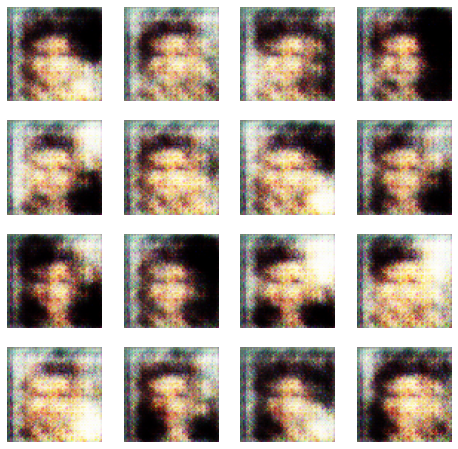

iteration  600  gen loss 1.9757779  disc loss 0.54218584
**** INCEPTION DISTANCE: 528.538 ****


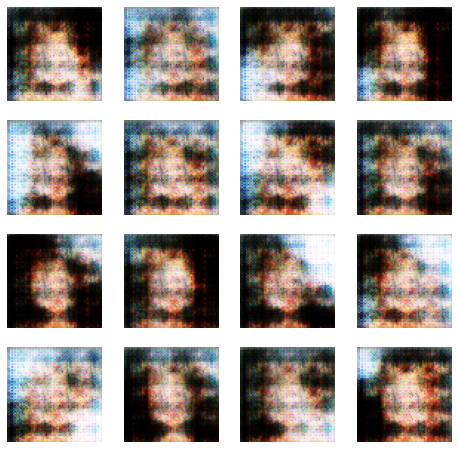

iteration  700  gen loss 2.3902524  disc loss 0.62913
**** INCEPTION DISTANCE: 427.238 ****


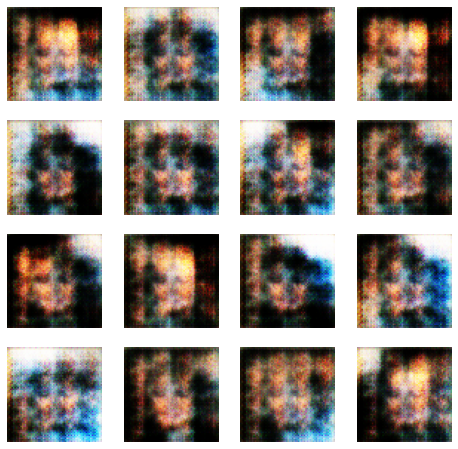

iteration  800  gen loss 1.4457788  disc loss 0.9083497
**** INCEPTION DISTANCE: 495.048 ****


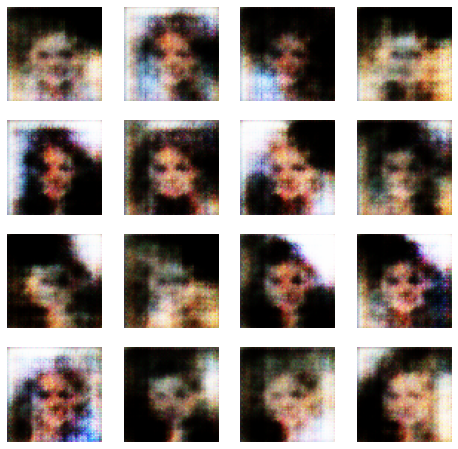

iteration  900  gen loss 2.0729225  disc loss 0.6687354
**** INCEPTION DISTANCE: 390.699 ****


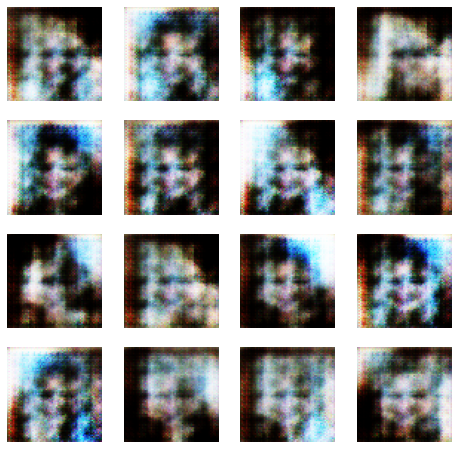

iteration  1000  gen loss 2.431995  disc loss 0.65591985
**** INCEPTION DISTANCE: 369.558 ****


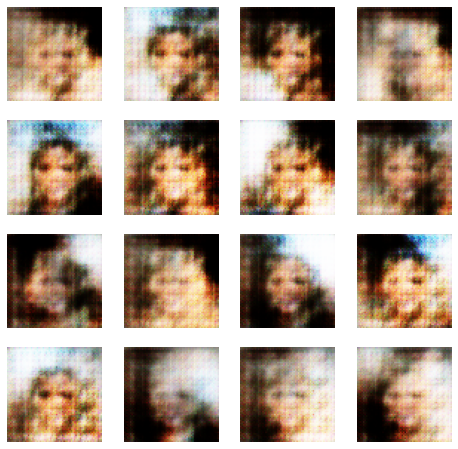

iteration  1100  gen loss 1.6293032  disc loss 0.9329594
**** INCEPTION DISTANCE: 357.382 ****


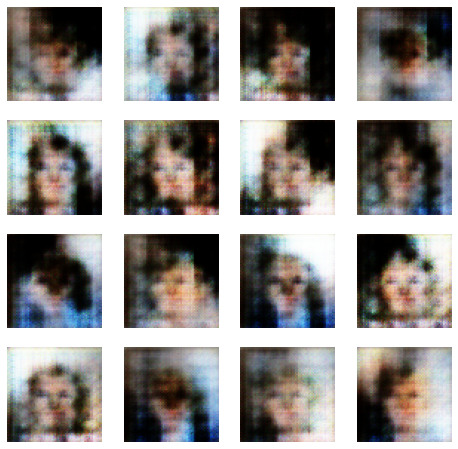

iteration  1200  gen loss 1.8424613  disc loss 0.7087506
**** INCEPTION DISTANCE: 451.514 ****


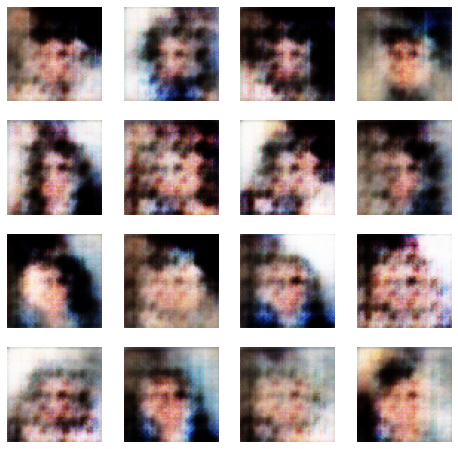

iteration  1300  gen loss 2.1404796  disc loss 0.8318918
**** INCEPTION DISTANCE: 347.879 ****


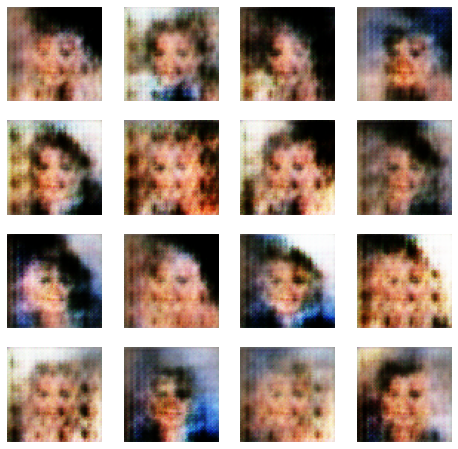

iteration  1400  gen loss 1.982494  disc loss 0.69375765
**** INCEPTION DISTANCE: 397.591 ****


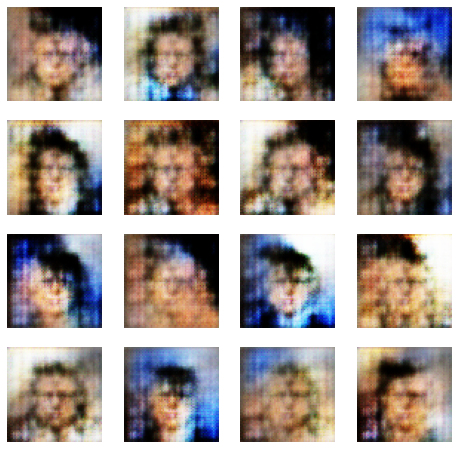

iteration  1500  gen loss 2.070123  disc loss 1.08058
**** INCEPTION DISTANCE: 315.451 ****


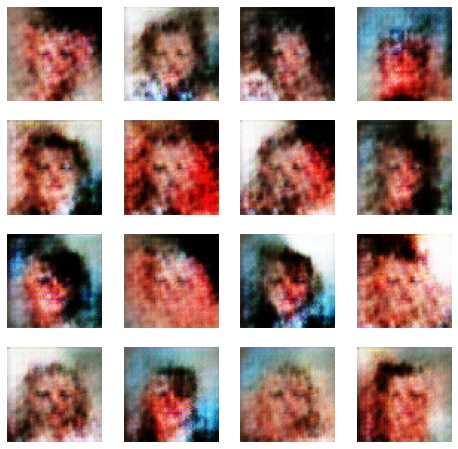

tf.Tensor(12340.82, shape=(), dtype=float32)
Average FID for Epoch: 7.800771373261694
**** SAVING CHECKPOINT AT END OF EPOCH ****


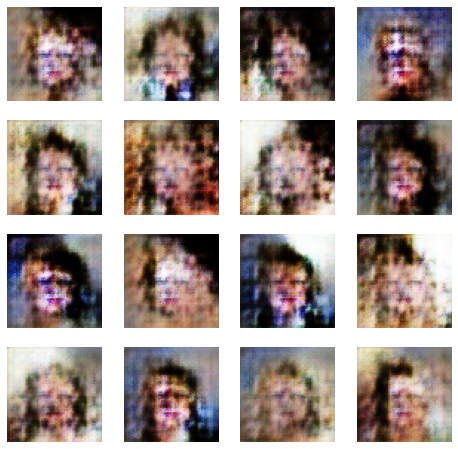

========================== EPOCH 1  ==========================
iteration  0  gen loss 1.8890445  disc loss 0.6456783
**** INCEPTION DISTANCE: 377.546 ****


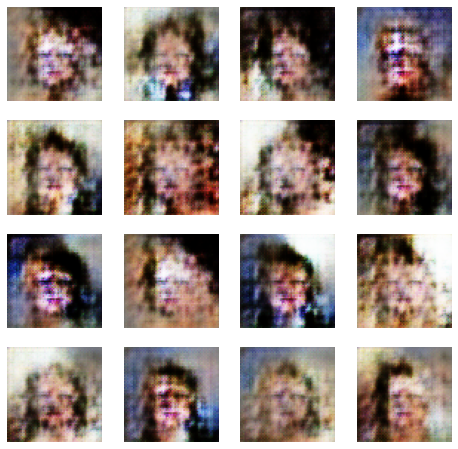

iteration  100  gen loss 2.0246754  disc loss 0.92324495
**** INCEPTION DISTANCE: 372.21 ****


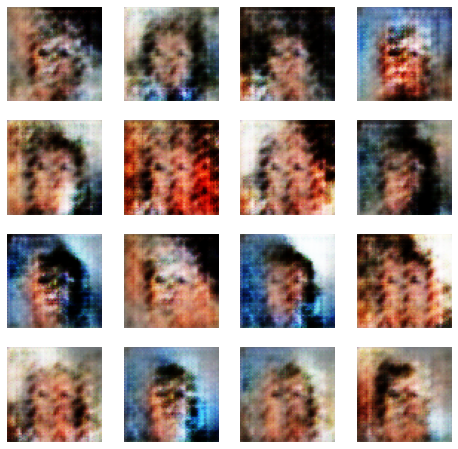

iteration  200  gen loss 1.7330352  disc loss 0.75450754
**** INCEPTION DISTANCE: 368.459 ****


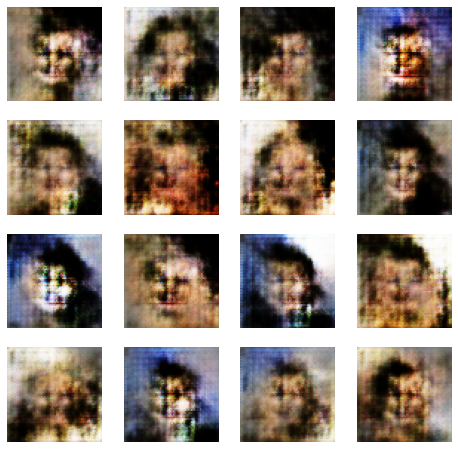

iteration  300  gen loss 1.6251854  disc loss 0.9194318
**** INCEPTION DISTANCE: 290.846 ****


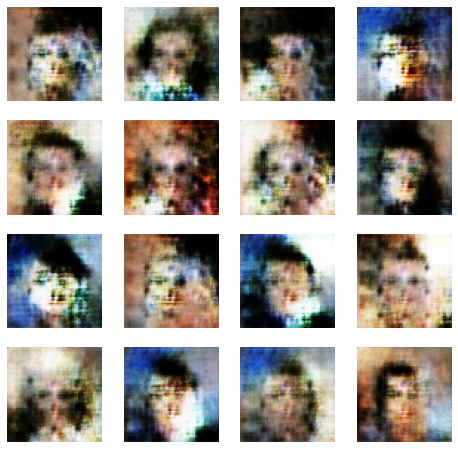

iteration  400  gen loss 1.5745723  disc loss 0.88523483
**** INCEPTION DISTANCE: 400.605 ****


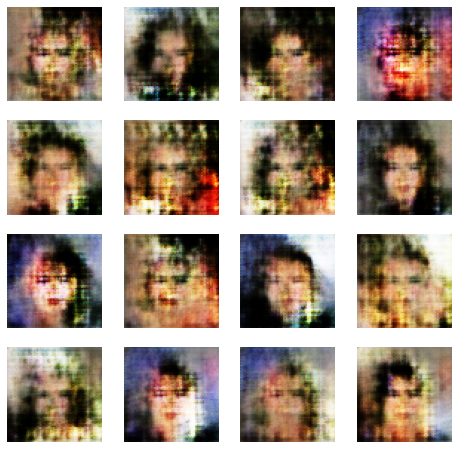

iteration  500  gen loss 1.9513983  disc loss 0.63970244
**** INCEPTION DISTANCE: 391.732 ****


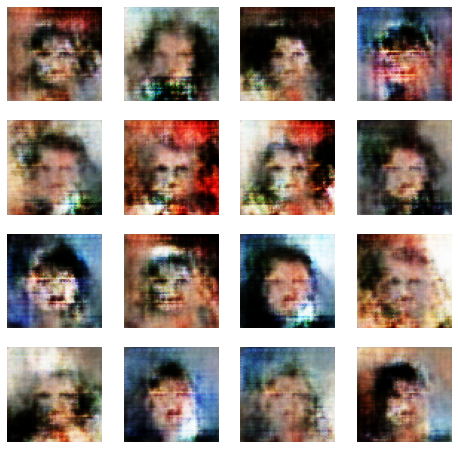

iteration  600  gen loss 1.7727948  disc loss 0.6343038
**** INCEPTION DISTANCE: 418.605 ****


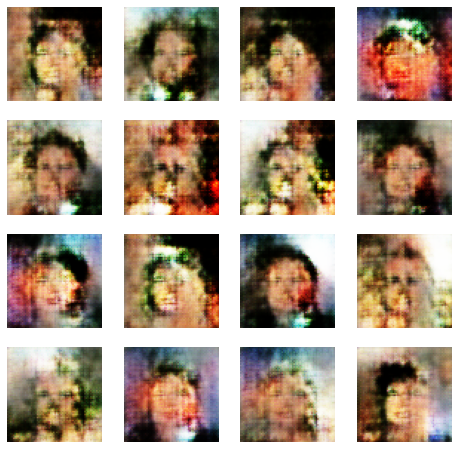

iteration  700  gen loss 1.6757135  disc loss 0.9267606
**** INCEPTION DISTANCE: 306.079 ****


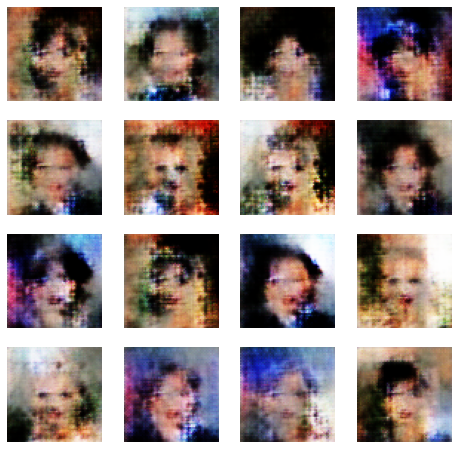

iteration  800  gen loss 1.6448178  disc loss 0.90208876
**** INCEPTION DISTANCE: 357.667 ****


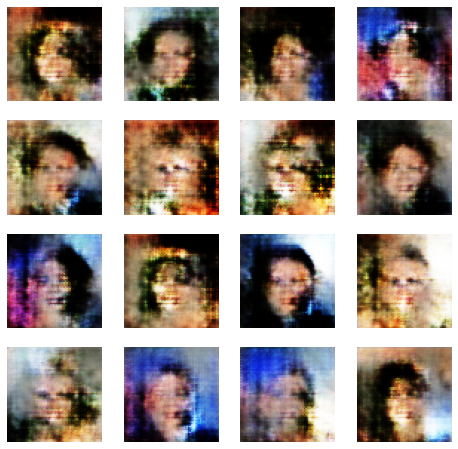

iteration  900  gen loss 1.5576593  disc loss 1.2518895
**** INCEPTION DISTANCE: 246.703 ****


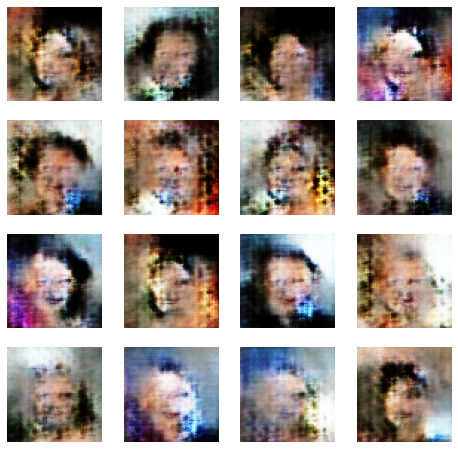

iteration  1000  gen loss 1.6099119  disc loss 0.7215513
**** INCEPTION DISTANCE: 331.621 ****


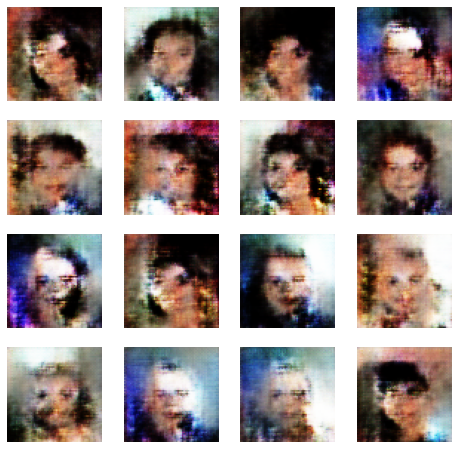

iteration  1100  gen loss 1.3829423  disc loss 1.1120753
**** INCEPTION DISTANCE: 351.051 ****


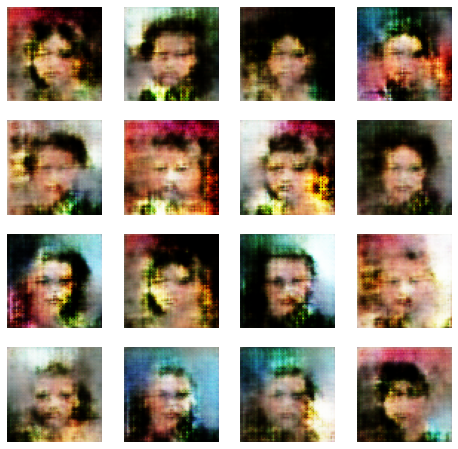

iteration  1200  gen loss 1.9069703  disc loss 0.92019945
**** INCEPTION DISTANCE: 302.2 ****


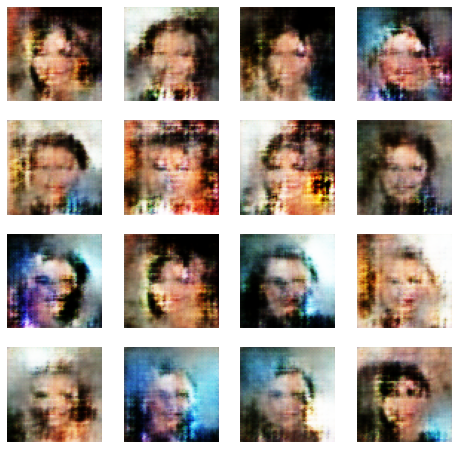

iteration  1300  gen loss 1.2467849  disc loss 1.0544565
**** INCEPTION DISTANCE: 335.531 ****


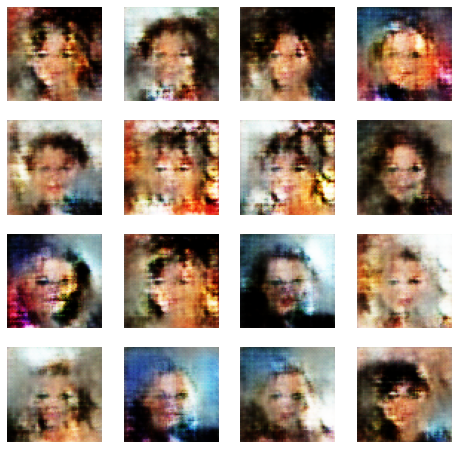

iteration  1400  gen loss 1.5809925  disc loss 0.9223265
**** INCEPTION DISTANCE: 331.521 ****


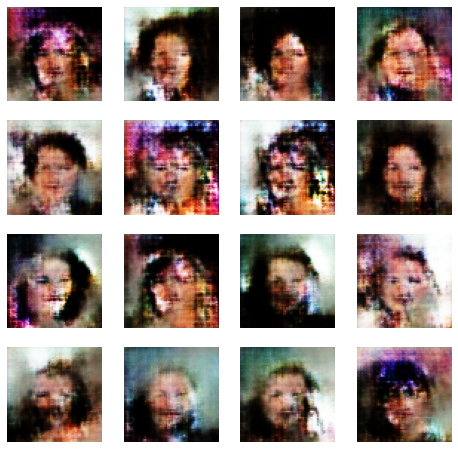

iteration  1500  gen loss 1.41619  disc loss 0.9444452
**** INCEPTION DISTANCE: 255.881 ****


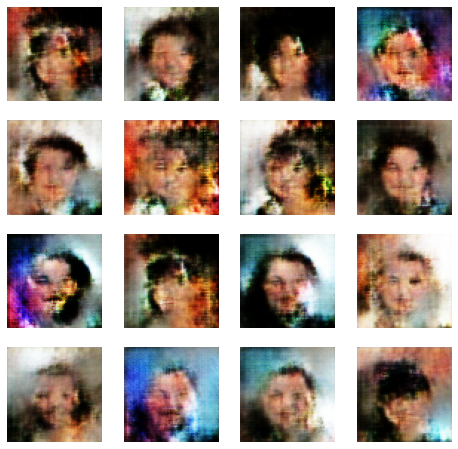

tf.Tensor(5438.258, shape=(), dtype=float32)
Average FID for Epoch: 3.4375839522756007
**** SAVING CHECKPOINT AT END OF EPOCH ****


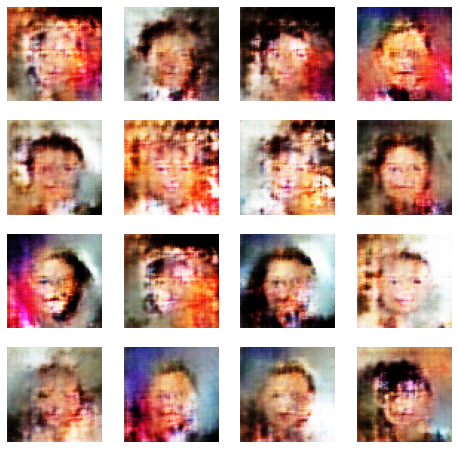

========================== EPOCH 2  ==========================
iteration  0  gen loss 1.4358773  disc loss 0.8816291
**** INCEPTION DISTANCE: 324.811 ****


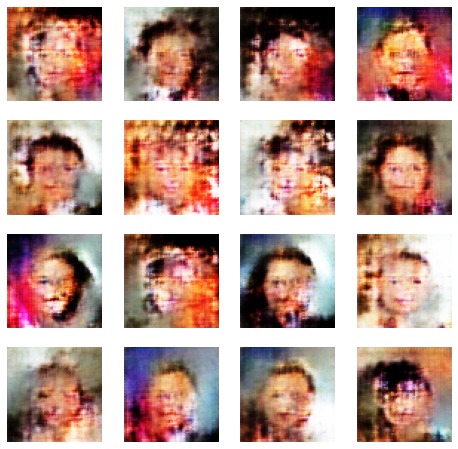

iteration  100  gen loss 1.2678806  disc loss 1.068623
**** INCEPTION DISTANCE: 254.809 ****


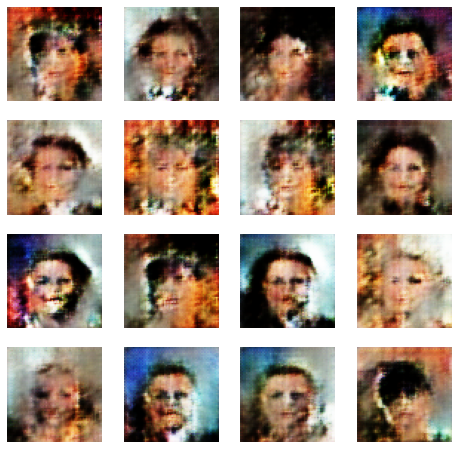

iteration  200  gen loss 1.7134416  disc loss 0.8761072
**** INCEPTION DISTANCE: 348.264 ****


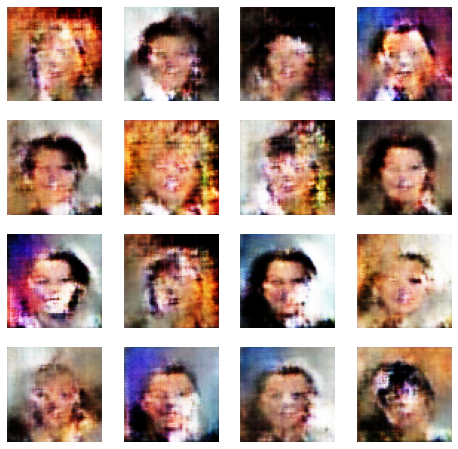

iteration  300  gen loss 1.221758  disc loss 1.1262958
**** INCEPTION DISTANCE: 257.685 ****


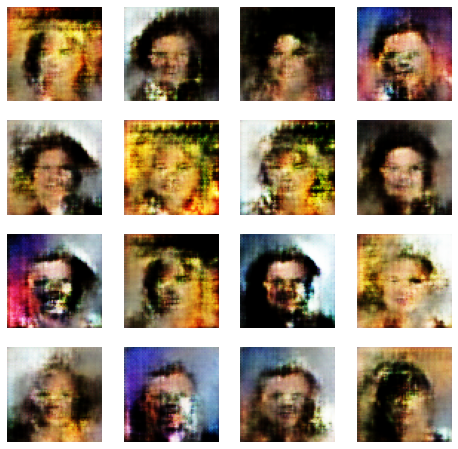

iteration  400  gen loss 1.5360934  disc loss 1.1093307
**** INCEPTION DISTANCE: 333.088 ****


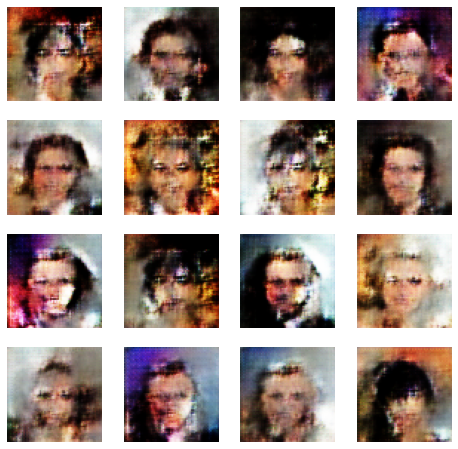

iteration  500  gen loss 1.1348722  disc loss 1.0084972
**** INCEPTION DISTANCE: 275.642 ****


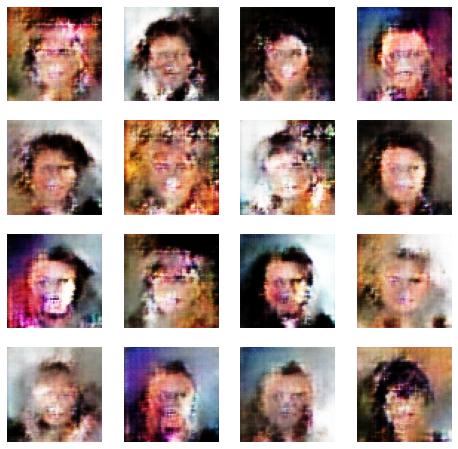

iteration  600  gen loss 1.5540854  disc loss 0.75905514
**** INCEPTION DISTANCE: 271.866 ****


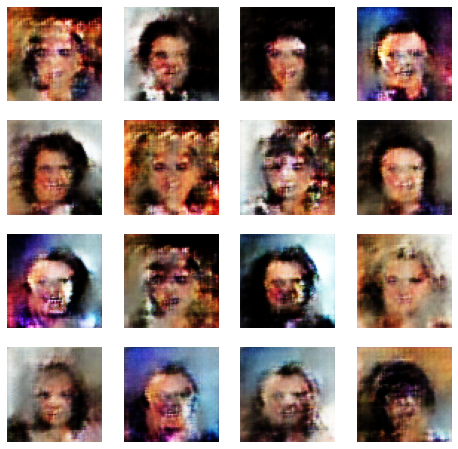

iteration  700  gen loss 1.891746  disc loss 0.8697531
**** INCEPTION DISTANCE: 280.599 ****


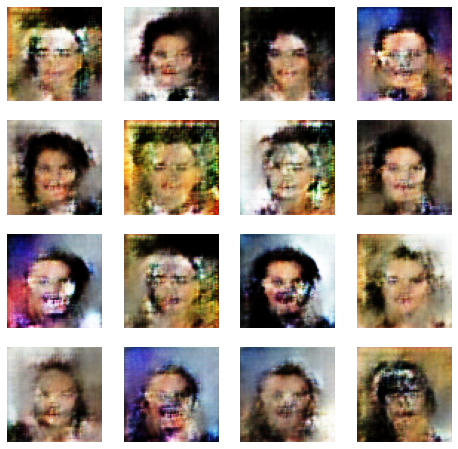

iteration  800  gen loss 1.3419911  disc loss 0.93632686
**** INCEPTION DISTANCE: 303.53 ****


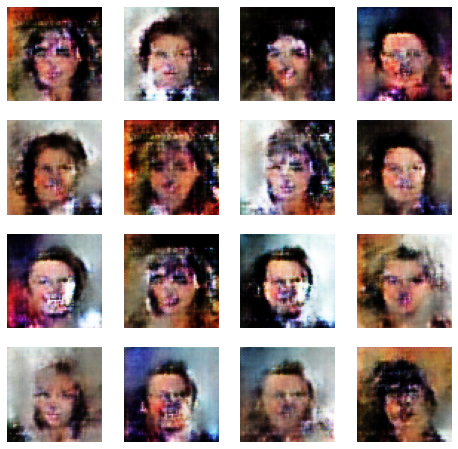

iteration  900  gen loss 1.1619518  disc loss 1.1603901
**** INCEPTION DISTANCE: 299.683 ****


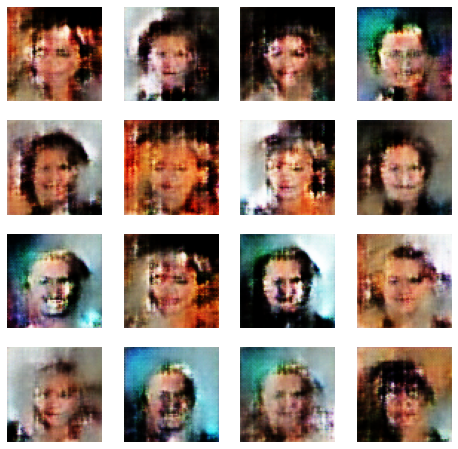

iteration  1000  gen loss 1.4122317  disc loss 0.89779025
**** INCEPTION DISTANCE: 216.995 ****


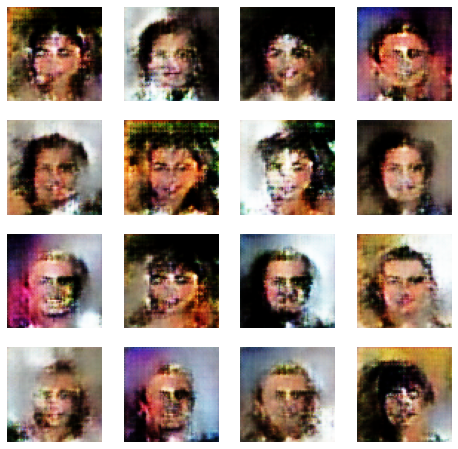

iteration  1100  gen loss 1.4401896  disc loss 0.9535816
**** INCEPTION DISTANCE: 258.972 ****


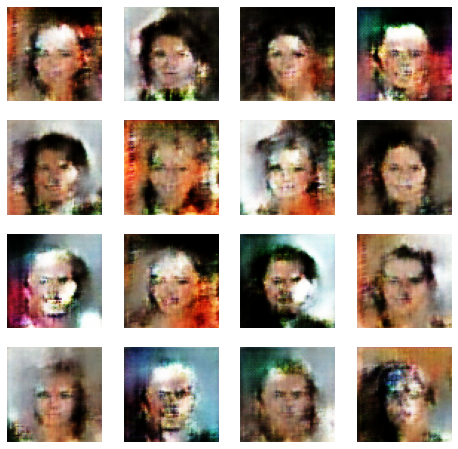

iteration  1200  gen loss 1.207073  disc loss 0.93200403
**** INCEPTION DISTANCE: 246.456 ****


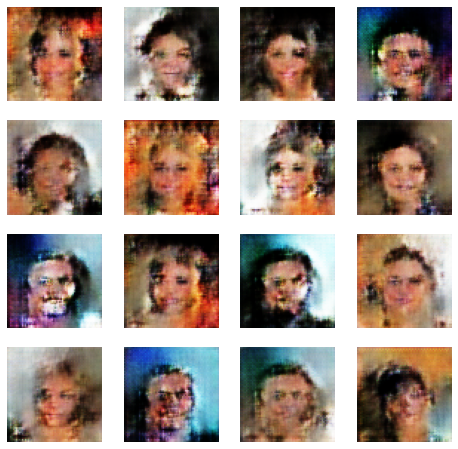

iteration  1300  gen loss 1.6705303  disc loss 0.9546124
**** INCEPTION DISTANCE: 237.782 ****


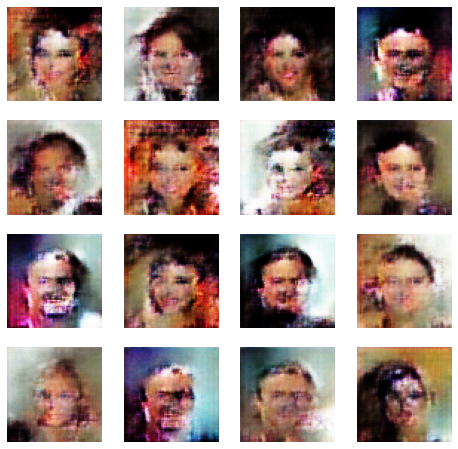

iteration  1400  gen loss 1.3142546  disc loss 0.74457276
**** INCEPTION DISTANCE: 285.939 ****


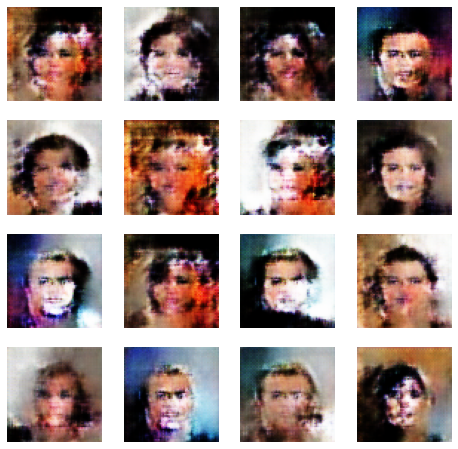

iteration  1500  gen loss 1.7886522  disc loss 0.80818427
**** INCEPTION DISTANCE: 226.394 ****


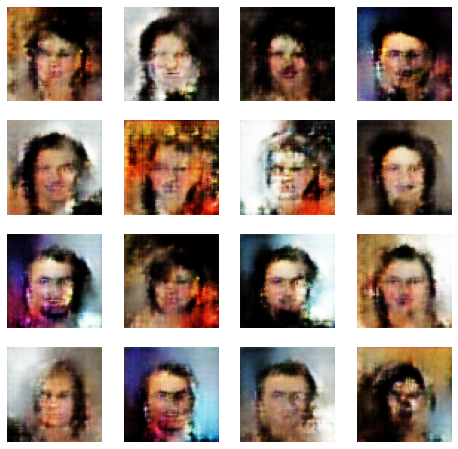

tf.Tensor(4422.5146, shape=(), dtype=float32)
Average FID for Epoch: 2.795521269555942
**** SAVING CHECKPOINT AT END OF EPOCH ****


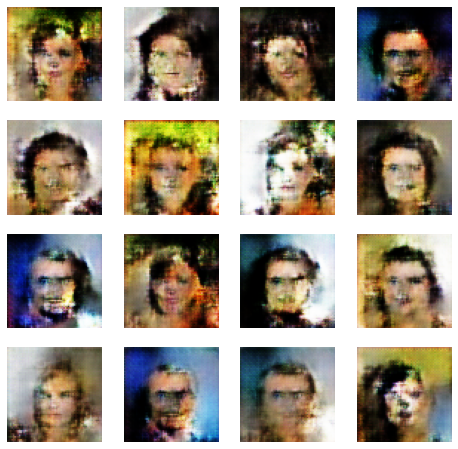

In [ ]:
# Load a batch of images (to feed to the discriminator)
dataset_iterator = load_image_batch(img_dir, batch_size=batch_size, n_threads=2)

# Initialize generator and discriminator models
generator = make_generator_model()
discriminator = make_discriminator_model()

#The discriminator and the generator optimizers are different since you will train two networks separately.
generator_optimizer = tf.keras.optimizers.Adam(0.0002, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(0.0002, beta_1=0.5)

# For saving/loading models
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)
manager = tf.train.CheckpointManager(checkpoint, checkpoint_dir, max_to_keep=3)
# Ensure the output directory exists
if not os.path.exists(out_dir):
    os.makedirs(out_dir)

if restore_checkpoint:
    # restores the latest checkpoint using from the manager
    checkpoint.restore(manager.latest_checkpoint) 

validate_image_seeds = tf.random.normal([batch_size, noise_dim])

if mode == 'train':
    for epoch in range(0, EPOCHS):
        print('========================== EPOCH %d  ==========================' % epoch)
        avg_fid = train_epoch(generator, discriminator, dataset_iterator, manager, 
                              batch_size=batch_size, validate_image_seeds=validate_image_seeds)
        print("Average FID for Epoch: " + str(avg_fid))
        # Save at the end of the epoch, too
        print("**** SAVING CHECKPOINT AT END OF EPOCH ****")
        manager.save()
        display_images(generator(validate_image_seeds, training=False), 
                       save='image_at_epoch_{:04d}.png'.format(epoch))

elif mode == 'test':
    display_images(generator(validate_image_seeds, training=False), save='image_test.png')




Assignment used with permission and significantly modified for use in COSC440 from CS1470 TA Staff | Computer Science Department | Brown University